<a href="https://colab.research.google.com/github/smarvar/endmembers/blob/main/MultispectralAnalisys_trigo_22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Librerias

In [1]:
# import all content drive 
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# Se importan las librerias a utilizar
import os, sys
from PIL import Image
import numpy as np
import h5py
import matplotlib.pyplot as plt
from tqdm import tqdm
import copy
!pip install pysptools
import pysptools
import h5py
from sklearn.preprocessing import normalize

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 8.1 MB 6.7 MB/s 
  Created wheel for pysptools: filename=pysptools-0.15.0-py3-none-any.whl size=8133751 sha256=4f4b4be02c13acfdc633f2b69619fef2490e5bd29950dc6fc3e5c44968ed6014
  Stored in directory: /root/.cache/pip/wheels/ee/61/31/fb8bf9e1d7508efcfce674a9dc4ac98e67cfe875a5567c4e7e
Successfully built pysptools


# Extracción de Endmembers 

## Se cargan las bandas y se procesan para su analisis

In [3]:
#path = "/Users/stevenmartine/Documents/Datasets/prueba_trigo_22/" #ruta con nombre original
path2 = "/content/drive/MyDrive/Proyectos_extra/Endemenbers_Trigo/hyper_trigo_22/" # ruta Drive

In [4]:
# Usar para renombrar las bandas y dejar unicamente el numero respectivo de banda, se hace solo la primer vez
"""dirs = os.listdir(path)
for file in dirs:
  n_band=file.find('WL_') #encontrar la posición que contiene el número de la banda
  im1 = Image.open(path+file)
  im1 = im1.save(path2+file[n_band+3:n_band+6]+'.tif') """

"dirs = os.listdir(path)\nfor file in dirs:\n  n_band=file.find('WL_') #encontrar la posición que contiene el número de la banda\n  im1 = Image.open(path+file)\n  im1 = im1.save(path2+file[n_band+3:n_band+6]+'.tif') "

Se genera un Hipercubo con todas las bandas a procesar

In [5]:
dirs2 = os.listdir(path2)
dirs2 = sorted(dirs2)
n_bands = len(dirs2) #numero total de bandas
y, x = 648, 1022 #Numero de pixeles por fila y col. Conocidos a priori
y_new, x_new = 500, 800
bands = np.zeros(shape=(y,x,n_bands))
hypercube = np.zeros(shape=(y_new,x_new,n_bands)) # se genera un hipercubo que contendra todas las bandas
cont = 0
# Se lee cada banda y se asigna a la posición respectiva del hypercubo
for file in dirs2:
  bands[:,:,cont] = Image.open(path2+file)
  cont+=1 
hypercube[:,:,:] = bands[50:550,100:900,:] # se cropea la imagen excluyendo los bordes que presentan ruido

In [6]:
# Se genera un lista con el numero de cada una de las bandas
dirs3=[]
for a in dirs2:
  dirs3.append(a[0:3])
print(dirs3)

['501', '513', '531', '533', '542', '549', '570', '604', '629', '670', '675', '679', '694', '696', '700', '704', '733', '750', '753', '774', '849', '860']


In [7]:
# Ver el contenido de una banda en especifico
print(hypercube[:,:,1])

[[ 457.  259.  232. ... 1670. 1622. 1965.]
 [ 158.  559.  221. ... 1567. 1761. 2312.]
 [ 567.  375.  517. ... 1429. 1687. 2152.]
 ...
 [ 546.  285.  264. ... 1371. 1182. 2453.]
 [ 243.  466.  530. ... 1137. 1377. 1812.]
 [ 317.  387.  400. ...  844. 1226. 1575.]]


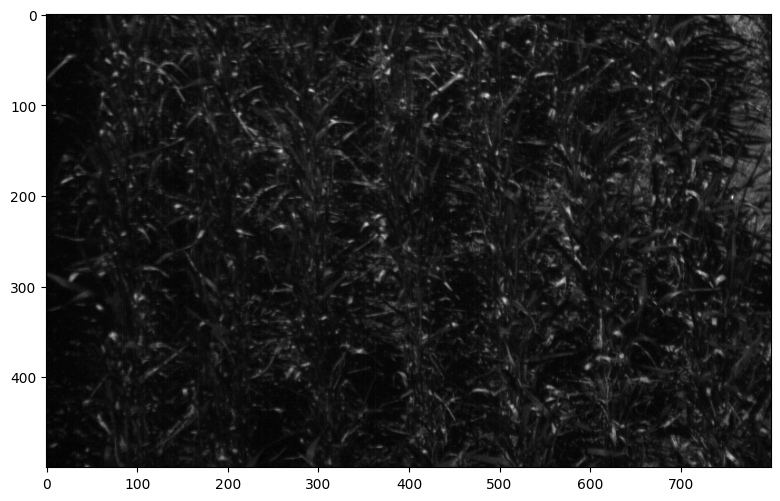

In [8]:
# Ploteo de una de las bandas
fig = plt.figure(figsize=(10,6), dpi=100)   
plt.imshow(hypercube[:,:,0], cmap='gray')
plt.show()

In [9]:
# Funcion para guardar los endmembers encontrados por los algoritmos
def guardar(dato,ruta,name): 
  with h5py.File(str(ruta)+'/'+str(name)+'.hdf5', 'w') as f:
      dset = f.create_dataset("default", data=dato)

In [10]:
ruta_save = '/Users/stevenmartine/Drive smarvar/Proyectos_extra/Endemenbers_Trigo/algorithm_results' # defino la ruta para guardar los endmembers encontrados

## Aplicación de los algoritmos endmemberd extraction de pystools

Se importan los paquetes de la libreria a utilizar

In [ ]:
#  Se importan los paquetes a utilizar de pystools
import pysptools.util as util
import pysptools.eea as eea #endmembers extraction algorithms
import pysptools.abundance_maps as amap
import pysptools.classification as cls
import pysptools.material_count as cnt
import time 
%matplotlib inline
#for clean output, to not print warnings, don't use when developing script
import warnings
warnings.filterwarnings('ignore')

###Fast Iterative Pixel Purity Index (FIPPI)

In [ ]:
start_time = time.time()
ee3 = eea.FIPPI() #Fast Iterative Pixel Purity Index (FIPPI)
n_endmembers = 22 #Defino el numero de endmembers a ser encontrado el cual no puede ser mayor al numero de bandas
U3 = ee3.extract(hypercube, q=n_endmembers)
elapsed_time = time.time() - start_time
print('Time: ' + str(elapsed_time/60) + ' Minutes')

Time: 0.9874125520388285 Minutes


In [ ]:
guardar(dato=U3,ruta=ruta_save,name='FIPPI')

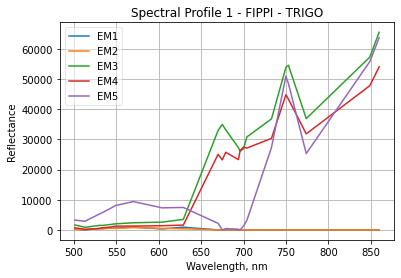

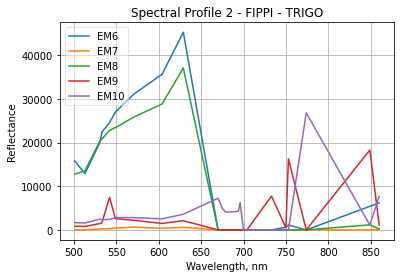

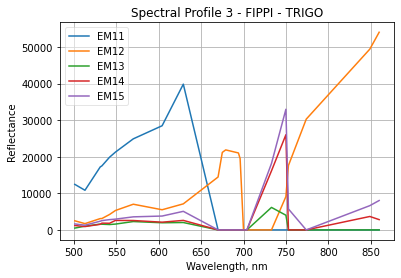

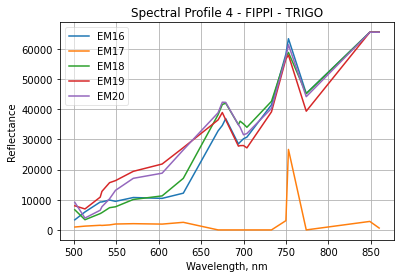

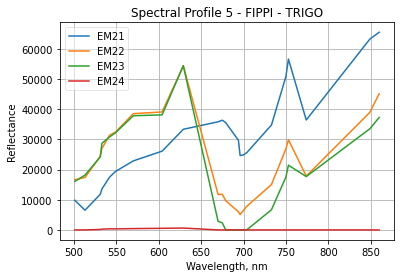

In [ ]:
ee3_axes = {}
ee3_axes['wavelength'] = [float(i) for i in dirs3]
ee3_axes['x']='Wavelength, nm' #x axis label
ee3_axes['y']='Reflectance' #y axis label 
ee3.display(axes=ee3_axes,suffix='TRIGO')

In [ ]:
ee3.plot(path='/Users/stevenmartine/Drive smarvar/Proyectos_extra/Endemenbers_Trigo/algorithm_results/',axes=ee3_axes,suffix='TRIGO')

24 endmemberds encontrados, por lo cual definire el numero de endmemberds para los otros algoritmos como 24, para luego ver una comparación

###N-FINDR endmembers induction algorithm.

In [ ]:
start_time = time.time()
ee = eea.NFINDR() #N-FINDR endmembers induction algorithm.
n_endmembers = 22 # number endmembers to find
U = ee.extract(hypercube,q=n_endmembers,maxit=None,normalize=False, ATGP_init=True)
elapsed_time = time.time() - start_time
print('Time: ' + str(elapsed_time/60) + ' Minutes')

Time: 3.7797233939170836 Minutes


In [ ]:
guardar(dato=U,ruta=ruta_save,name='NFINDR')

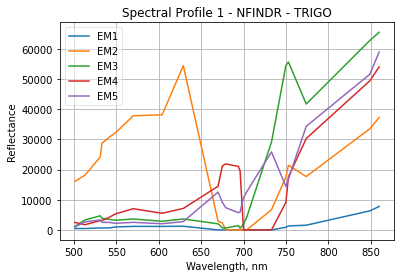

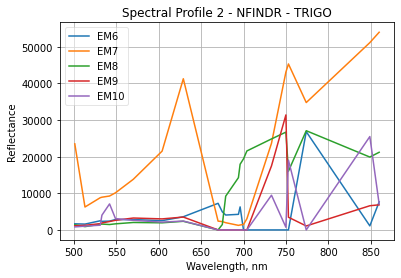

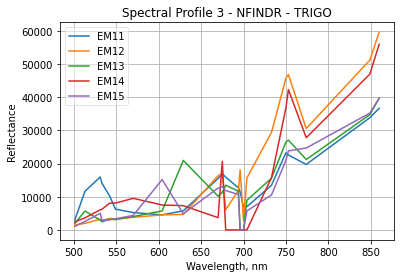

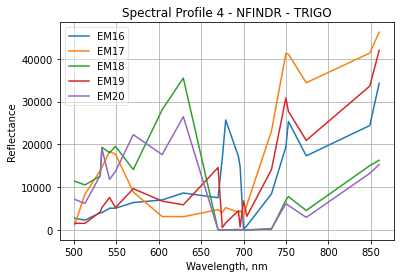

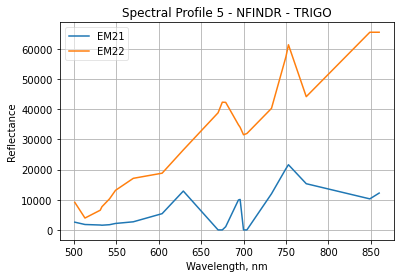

In [ ]:
# Spectral endmembers 
ee_axes = {}
ee_axes['wavelength'] = [float(i) for i in dirs3]
ee_axes['x']='Wavelength, nm' #x axis label
ee_axes['y']='Reflectance' #y axis label 
ee.display(axes=ee_axes,suffix='TRIGO')

###Automatic Target Generation Process (ATGP)

In [ ]:
start_time = time.time()
ee2 = eea.ATGP() #Automatic Target Generation Process (ATGP)
n_endmembers = 22
U2 = ee2.extract(hypercube,n_endmembers)
guardar(dato=U2,ruta=ruta_save,name='ATGP')
elapsed_time = time.time() - start_time
print('Time: ' + str(elapsed_time/60) + ' Minutes')

Time: 0.6584285815556844 Minutes


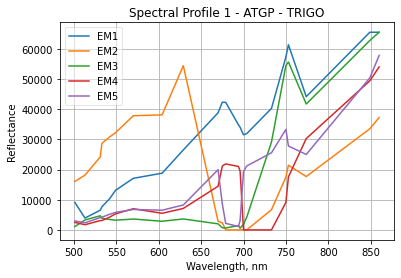

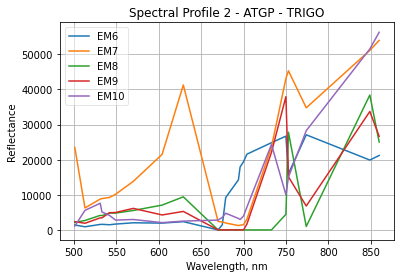

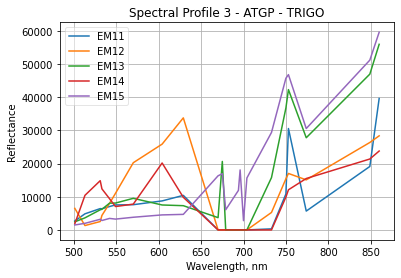

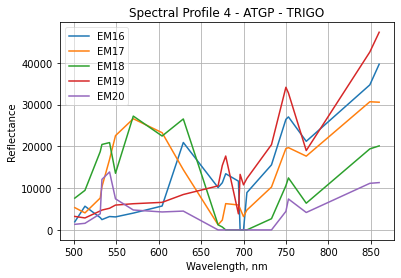

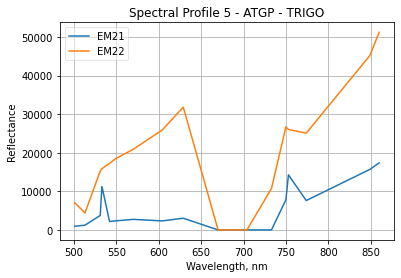

In [ ]:
ee2_axes = {}
ee2_axes['wavelength'] = [float(i) for i in dirs3]
ee2_axes['x']='Wavelength, nm' #x axis label
ee2_axes['y']='Reflectance' #y axis label 
ee2.display(axes=ee2_axes,suffix='TRIGO')

###Pixel Purity Index (PPI)

In [ ]:
start_time = time.time()
ee4 = eea.PPI() #Pixel Purity Index (PPI)
n_endmembers = 22
U4 = ee4.extract(hypercube,n_endmembers)
guardar(dato=U4,ruta=ruta_save,name='PPI')
print('Time: ' + str(elapsed_time/60) + ' Minutes')

Time: 3.7797233939170836 Minutes


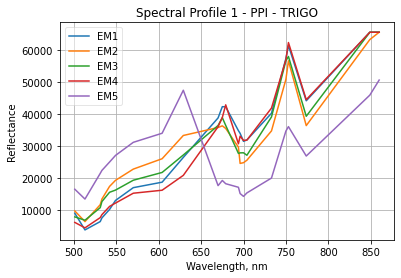

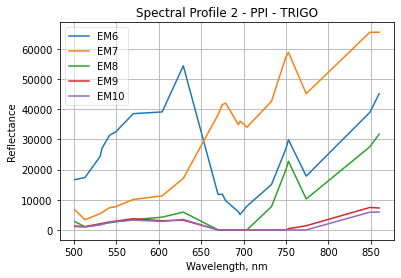

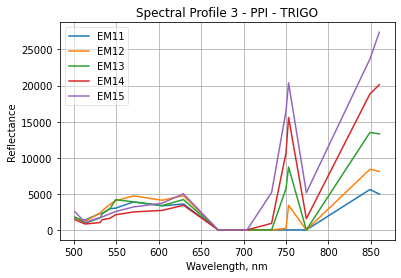

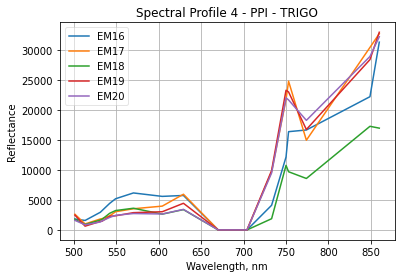

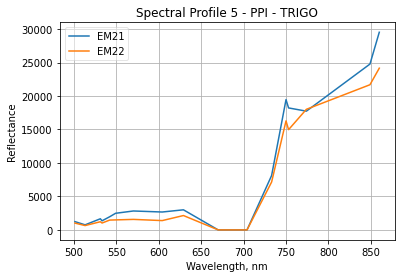

In [ ]:
ee4_axes = {}
ee4_axes['wavelength'] = [float(i) for i in dirs3]
ee4_axes['x']='Wavelength, nm' #x axis label
ee4_axes['y']='Reflectance' #y axis label 
ee4.display(axes=ee4_axes,suffix='TRIGO')

## Abrir Endmembers por cada algoritmo procesaso previamente

In [14]:
# Open endmembers found diferent algorithms
path3 = '/content/drive/MyDrive/Proyectos_extra/Endemenbers_Trigo/algorithm_results/'
f1 = h5py.File(path3 + 'NFINDR.hdf5', 'r')
U_NFINDR = f1['default']
f2 = h5py.File(path3 + 'ATGP.hdf5', 'r')
U_ATGP = f2['default']
f3 = h5py.File(path3 + 'FIPPI.hdf5', 'r')
U_FIPPI = f3['default']
f4 = h5py.File(path3 + 'PPI.hdf5', 'r')
U_PPI = f4['default']
data={} # Se crea un diccionario que contiene todos los endmembers por algoritmo
data['U_NFINDR']=U_NFINDR
data['U_ATGP'] = U_ATGP
data['U_FIPPI']= U_FIPPI
data['U_PPI'] = U_PPI
data

{'U_NFINDR': <HDF5 dataset "default": shape (22, 22), type "<f4">,
 'U_ATGP': <HDF5 dataset "default": shape (22, 22), type "<f4">,
 'U_FIPPI': <HDF5 dataset "default": shape (24, 22), type "<f4">,
 'U_PPI': <HDF5 dataset "default": shape (22, 22), type "<f4">}

## Analisis de coincidencia entre los algoritmos usados Cohen Kappa

In [ ]:
data.keys()

dict_keys(['U_NFINDR', 'U_ATGP', 'U_FIPPI', 'U_PPI'])

In [ ]:
from sklearn.metrics import cohen_kappa_score
n_endmembers = 36
# by endmmebers number 
[cohen_kappa_score(data['U_NFINDR'][:][a], data['U_ATGP'][:][a]) for a in range(n_endmembers)]

In [ ]:
[cohen_kappa_score(data['U_NFINDR'][:][a], data['U_PPI'][:][a]) for a in range(n_endmembers)]

In [ ]:
[cohen_kappa_score(data['U_ATGP'][:][a], data['U_PPI'][:][a]) for a in range(n_endmembers)]

In [ ]:
# reshape to one col
U_NFINDR2 = np.array(U_NFINDR)
U_NFINDR2 = U_NFINDR2.reshape((-1))
U_ATGP2 = np.array(U_ATGP)
U_ATGP2 = U_ATGP2.reshape((-1))
U_PPI2 = np.array(U_PPI)
U_PPI2 = U_PPI2.reshape((-1))

In [ ]:
# by algorithm accord
print(cohen_kappa_score(U_NFINDR2, U_ATGP2))
print(cohen_kappa_score(U_NFINDR2, U_PPI2))
print(cohen_kappa_score(U_ATGP2, U_PPI2))

0.22514057381161134
0.057345048514599206
0.15172327894521465


## Endmemberd por pixel

Producto escalar entre cada pixel del hipercubo y cada uno de los endmembers encontrados por el algortimo, donde se marca el pixel con el número de endmember que mayor producto escalar genere.

###Procesamiento

In [15]:
# Se deben cargar  primero los resultados de los algoritmos y generar el diccionario que los contiene. Proceso dado en el segmento anterior
"""Esta funcion retorna una matriz donde donde en cada pixel se asigna el endmember 
con mayor producto escala entre el todos los endmembers encontrados por el algoritmo y todas las bandas del hipercubo"""

def endmember_pixel(endmembers, hypercube, figure=False, ruta=''):
  #norm = normalize(endmembers, axis=0) #Se normalizan los datos previo al producto escalar entre el hipercubo y los endmembers
  norm = np.linalg.norm(endmembers)
  norm_endmembers = endmembers/norm  # normalized matrix
  y,x,_ = hypercube.shape
  out = np.zeros((y,x))
  for a in tqdm (range(y)):
    for b in range(x):
      value = [np.dot(hypercube[a,b,:], norm_endmembers[i]) for i in range(len(norm_endmembers))] #producto escalar entre el array endmember y el pixel hipercubo 
      out[a,b] = np.where(value == np.max(value))[0][0] # se asigna el número de endmember con mayor producto escalar
 
  if figure:
    fig = plt.figure(figsize=(10,6), dpi=100)  
    plt.imshow(out*255.0/out.max(), cmap='gist_rainbow')
    plt.axis('off')
    #plt.savefig(ruta, dpi=200)
    plt.show()
  return out

In [16]:
# Genera una lista con los endmembers encontrados
def data_unique(endmember):
    data = endmember.reshape(-1)
    result = []
    for item in data:
        if item not in result:
            result.append(item)
    return sorted(result)

100%|██████████| 500/500 [00:27<00:00, 18.44it/s]


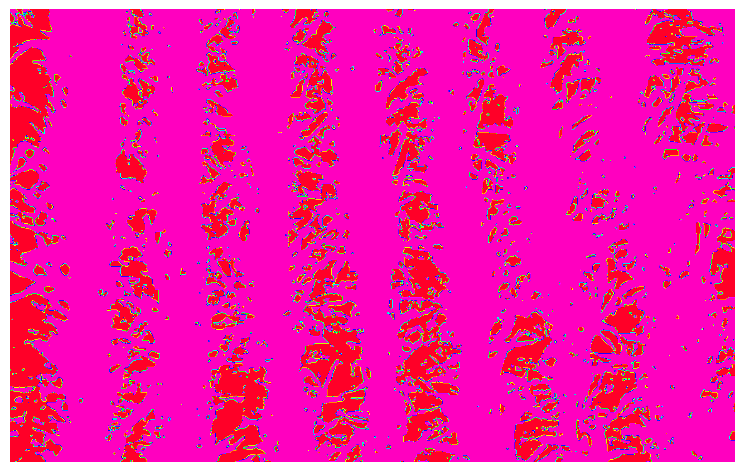

In [17]:
NFINDR_P = endmember_pixel(data['U_NFINDR'], hypercube, figure=True, ruta=ruta_save+'/NFINDR.png')

100%|██████████| 500/500 [00:27<00:00, 18.37it/s]


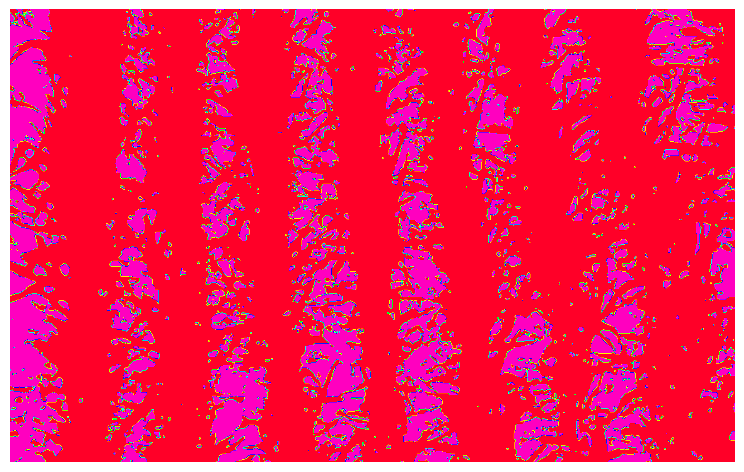

In [18]:
ATGP_P = endmember_pixel(data['U_ATGP'], hypercube, figure=True, ruta=ruta_save+'/ATGP.png')

100%|██████████| 500/500 [00:30<00:00, 16.44it/s]


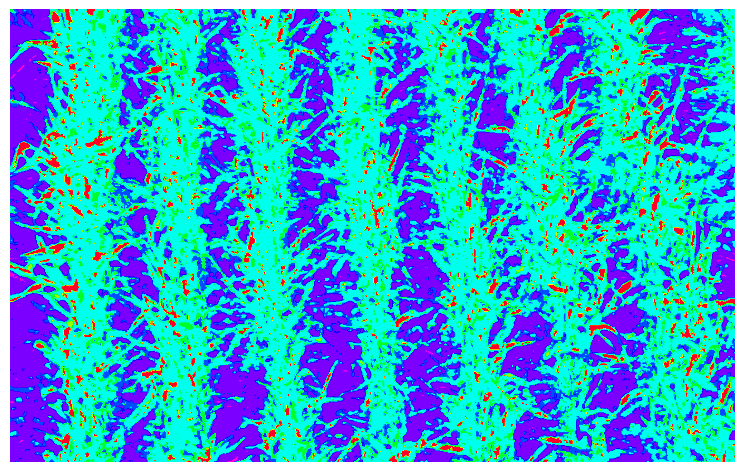

In [19]:
FIPPI_P = endmember_pixel(data['U_FIPPI'], hypercube, figure=True, ruta=ruta_save+'/FIPPI.png')

100%|██████████| 500/500 [00:34<00:00, 14.45it/s]


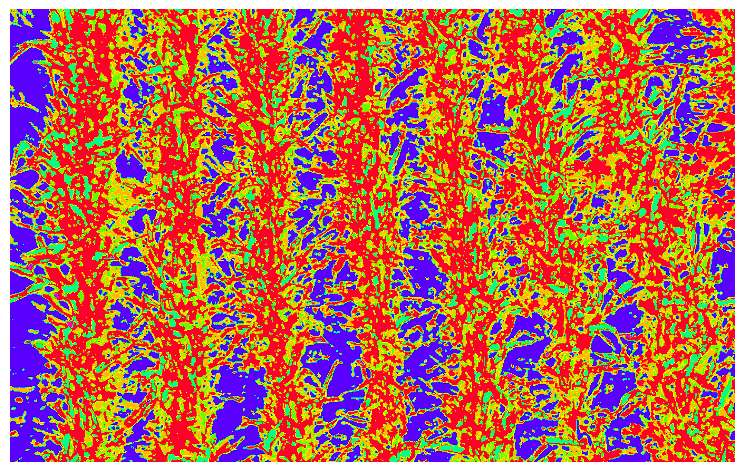

In [20]:
PPI_P = endmember_pixel(data['U_PPI'], hypercube, figure=True, ruta=ruta_save+'/PPI.png')

Cantidad de endmembers encontrados por algortimo

In [21]:
print('NFINDR_P:', data_unique(NFINDR_P))
print('ATGP_P:', data_unique(ATGP_P))
print('FIPPI_P:', data_unique(FIPPI_P))
print('PPI_P:', data_unique(PPI_P))

NFINDR_P: [1.0, 21.0]
ATGP_P: [0.0, 1.0]
FIPPI_P: [15.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0]
PPI_P: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0]


##Generar Imagen RGB

Imagen RGB

In [28]:
# Función que permite convertir una banda espectral en una imagen uint(0-255) y a traves de un factor ajustar la cromaticidad de la imagen
def conver_int(hyper, factor=1):
  max = hyper.max()
  min = hyper.min()
  m = float(255.0/(max-min))
  b = float(-m*min)
  y = (m*hyper + b)
  y = (y*factor)
  y = np.clip(y,0,255)
  y = y.astype(int)
  return y

In [29]:
# Función que permite obtener el promedio de un rango de bandas
def promedio(hypercube,start,stop):
  rango = np.arange(start,stop,1)
  y,x,_ = hypercube.shape
  prom = np.zeros((y,x))
  for a in (rango):
    prom[:,:] = prom[:,:] + hypercube[:,:,a]
  prom = prom/len(rango)
  return prom  

In [30]:
#Set de funciones que permten ajustar la luminancia de una imagen RGB
def YIQ(im):
  r, g, b = im[:,:,0], im[:,:,1], im[:,:,2]
  r, g, b = r.astype(float)/255, g.astype(float)/255, b.astype(float)/255
  Y = 0.299*r + 0.587*g + 0.114*b
  I = 0.595716*r - 0.274453*g - 0.321263*b 
  Q = 0.211456*r - 0.522591*g + 0.311135*b
  return Y,I,Q

def RGB (y,i,q):
  r = ((y + 0.9468822170900693*i + 0.6235565819861433*q)*255).astype(int)
  g = ((y - 0.27478764629897834*i - 0.6356910791873801*q)*255).astype(int)
  b = ((y - 1.1085450346420322*i + 1.7090069284064666*q)*255).astype(int)
  r = np.clip(r,0,255)
  g = np.clip(g,0,255)
  b = np.clip(b,0,255)
  rgb = np.zeros((y.shape[0],y.shape[1],3), 'uint8')
  rgb[..., 0] = r
  rgb[..., 1] = g
  rgb[..., 2] = b
  return rgb

def luminancia(img,alfa=1):
  Y,I,Q = YIQ(img)
  Y2 = alfa*Y
  Y2 = np.clip(Y2,0,1)
  out =RGB(Y2,I,Q)
  return out

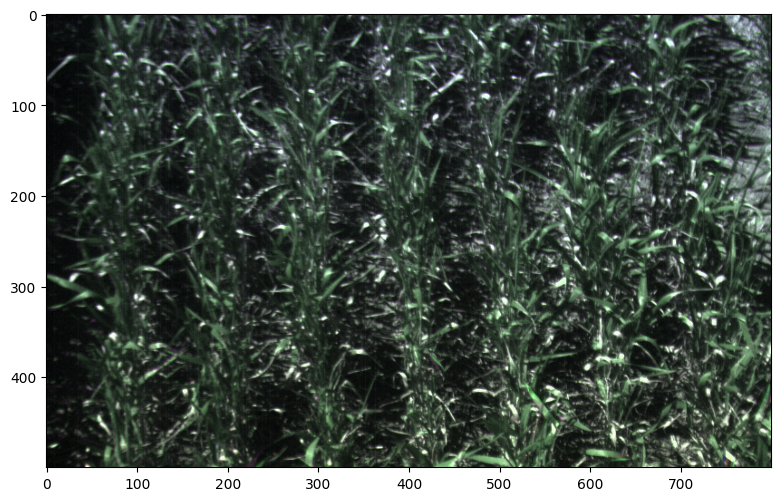

In [31]:
# Se genera una Imagen RGB tomando 3 bandas, basandonos en el espectro Landsat 7. 
# Se ajustan individualmente las bandas, para lograr una mejor imagen
r = dirs3.index('629')
g = dirs3.index('549')
b = dirs3.index('501')
factor_r = 0.7
factor_g = 0.9
factor_b = 0.8
factor_alfa = 2.5
pseudo_img = np.zeros((y_new,x_new,3),'uint8')
pseudo_img[:,:,0] = conver_int(hypercube[:,:,r], factor_r)
pseudo_img[:,:,1] = conver_int(hypercube[:,:,g], factor_g)
pseudo_img[:,:,2] = conver_int(hypercube[:,:,b], factor_b)

#Se ajusta la luminacia de la imgagen RGB para obtener una imagen más clara
pseudo_img2 = luminancia(pseudo_img, alfa = factor_alfa) 
fig = plt.figure(figsize=(10,6), dpi=100)   
plt.imshow(pseudo_img2)
plt.show()

In [32]:
pseudo = Image.fromarray((pseudo_img2).astype(np.uint8))
pseudo.save('/content/drive/MyDrive/Proyectos_extra/Endemenbers_Trigo/'+'/pseudoimagen.png')

In [ ]:
path = '/content/drive/MyDrive/Colab Notebooks/Endemenbers_Trigo/pseudoimagen.png'
pseudo_img = np.array(Image.open(path))
fig = plt.figure(figsize=(10,6), dpi=100)   
plt.imshow(pseudo_img)
plt.show()

## Aplicar mascara por cada Endmemberd

In [34]:
# Función que genera una mascara para solo ver un endmember
def mascara(out, n_endmember): #parametreos de entrada: matriz de endmembers y numero de endmember a evaluar
  mask = copy.copy((out))
  if n_endmember <= out.max(): 
    mask[out != n_endmember] = 1
    mask[out == n_endmember] = 0
  else:
    print('Numero de endmember fuera de rango')
  return mask

In [72]:
# Se aplica la mascara para ver unicamente el endmember deseado
def endmember_mask(imagen, algoritmo, ruta_save='', figura=False, save=False):
  n_endmebers = data_unique(algoritmo)
  for n_end in n_endmebers:
    mask = mascara(algoritmo[:,:], n_endmember = n_end)
    salida = copy.copy((imagen))
    salida[:,:,0][mask == 0] = 255  
    salida[:,:,1][mask == 0] = 255  
    salida[:,:,2][mask == 0] = 0
    if figura:
      fig = plt.figure(figsize=(10,6), dpi=100)   
      plt.imshow(salida)
      plt.show()
    if save:
      result = Image.fromarray((salida).astype(np.uint8))
      result.save(str(ruta_save)+'/endmember_'+str(n_end)+'.png')

In [36]:
# Se aplica la mascara para ver unicamente el endmember deseado
def endmember_mask_by_endmember(imagen, algoritmo, end_1, end_2, end_3, no_end=True, ruta_save='', figura=True, save=False, dpi=100):
  n_endmebers = data_unique(algoritmo)  
  mask1 = mascara(algoritmo[:,:], n_endmember = end_1)
  mask2 = mascara(algoritmo[:,:], n_endmember = end_2)
  mask3 = mascara(algoritmo[:,:], n_endmember = end_3)
  salida = copy.copy((imagen))
  salida[:,:,0][mask1 == 0] = 255  
  salida[:,:,1][mask1 == 0] = 0  
  salida[:,:,2][mask1 == 0] = 0

  salida[:,:,0][mask2 == 0] = 0  
  salida[:,:,1][mask2 == 0] = 255  
  salida[:,:,2][mask2 == 0] = 255

  salida[:,:,0][mask3 == 0] = 0  
  salida[:,:,1][mask3 == 0] = 0  
  salida[:,:,2][mask3 == 0] = 255
  
  if figura:

    fig = plt.figure(figsize=(10,7), dpi=dpi)
    rows = 1
    columns = 2  
    if no_end:
      fig.add_subplot(rows, columns, 1)      
      plt.imshow(imagen)
      plt.axis('off')
      fig.add_subplot(rows, columns, 2)
      plt.imshow(algoritmo*255.0/algoritmo.max(), cmap='gist_rainbow')
      plt.axis('off')
      plt.show()
    else:
      fig.add_subplot(rows, columns, 1)      
      plt.imshow(salida)
      plt.axis('off')
      fig.add_subplot(rows, columns, 2)
      plt.imshow(algoritmo*255.0/algoritmo.max(), cmap='gist_rainbow')
      plt.axis('off')
      plt.show()

  if save:
    result = Image.fromarray((salida).astype(np.uint8))
    #result.save(str(ruta_save)+'/endmember_'+str(n_end)+'.png')

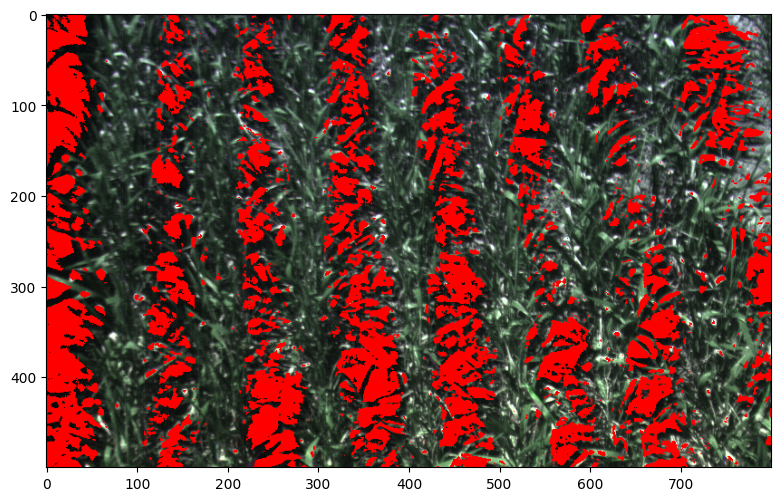

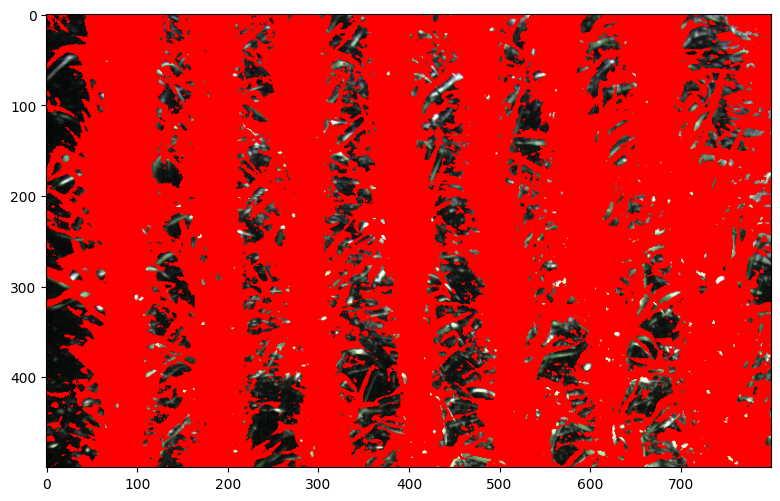

In [37]:
ruta_s ='/Users/stevenmartine/Drive smarvar/Proyectos_extra/Endemenbers_Trigo/algorithm_results/endmemberd_pseudoimg/FIPPI' 
endmember_mask(imagen=pseudo_img2, algoritmo=NFINDR_P, ruta_save=ruta_s, figura=True, save=False)

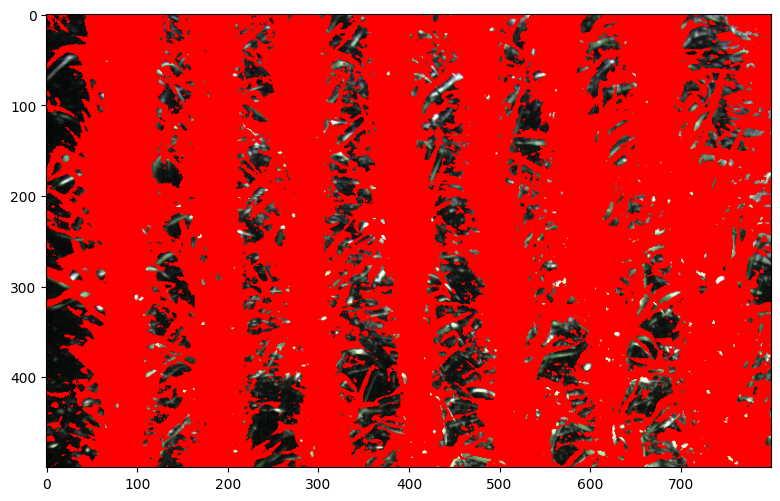

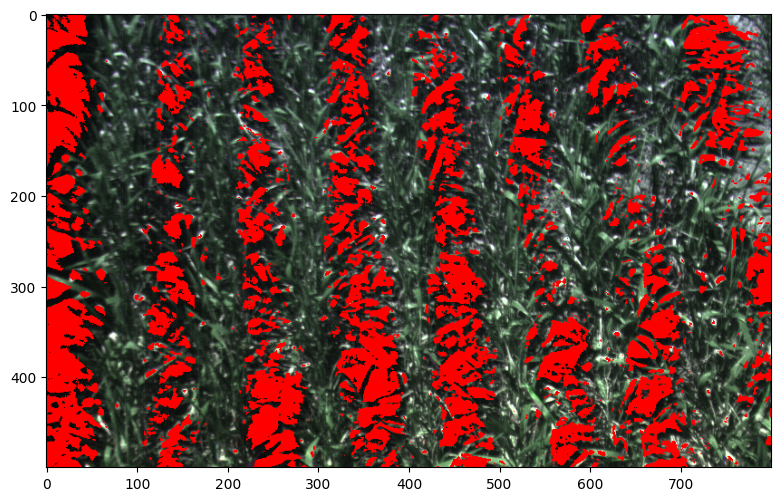

In [38]:
endmember_mask(imagen=pseudo_img2, algoritmo=ATGP_P, ruta_save=ruta_s, figura=True, save=False)

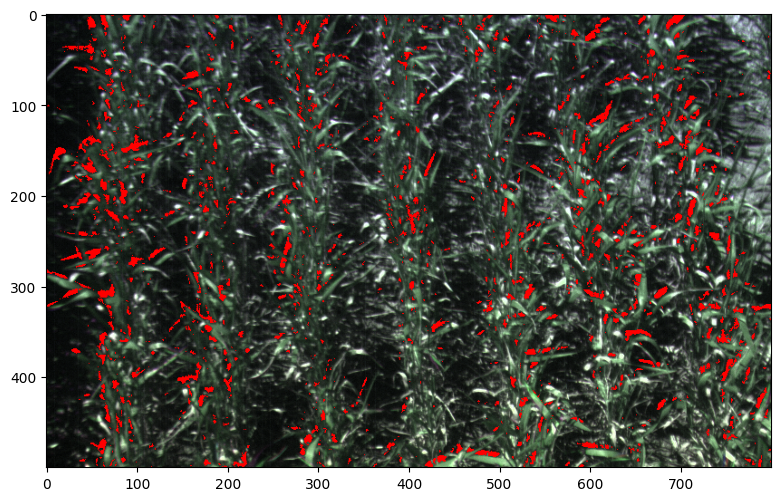

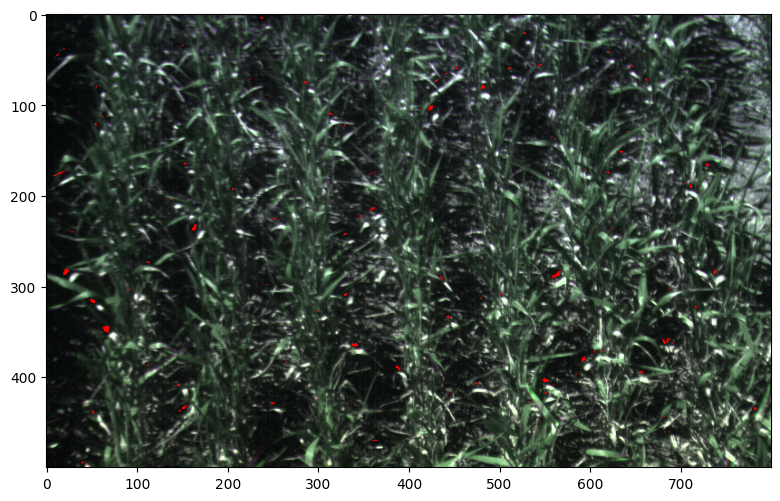

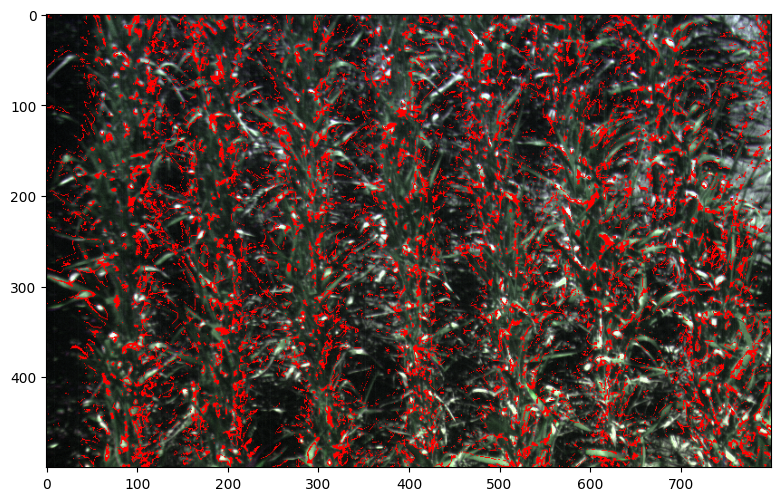

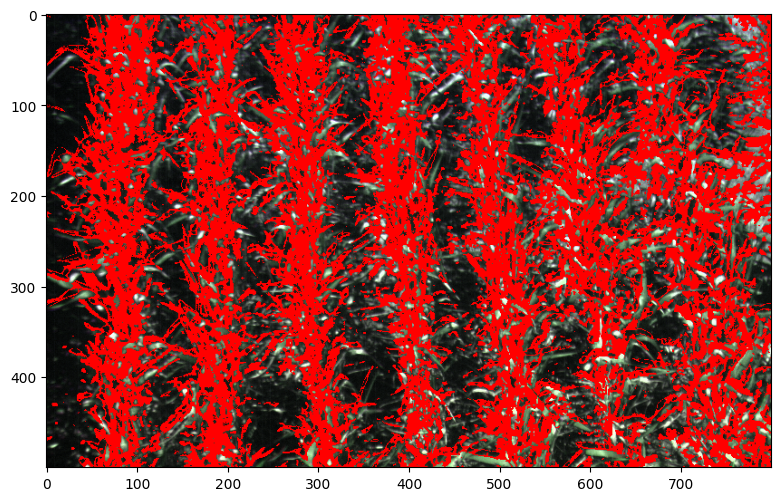

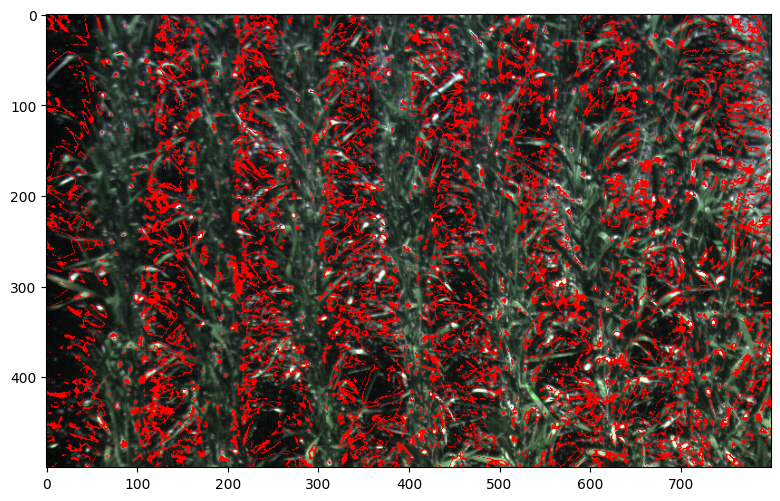

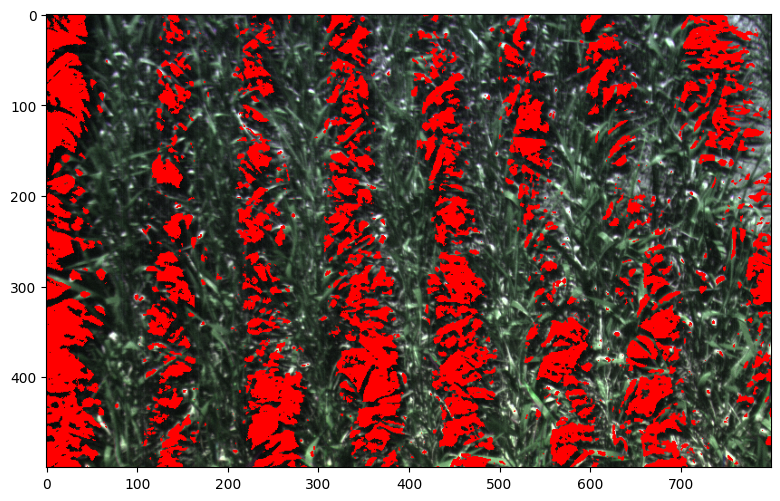

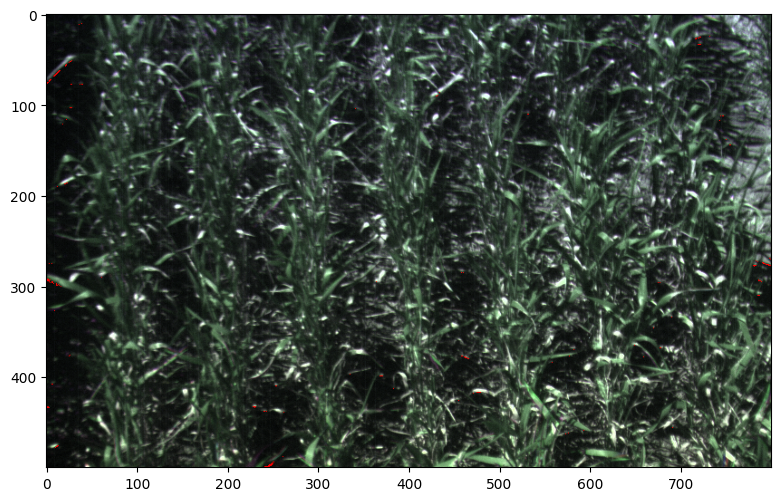

In [39]:
endmember_mask(imagen=pseudo_img2, algoritmo=FIPPI_P, ruta_save=ruta_s, figura=True, save=False)

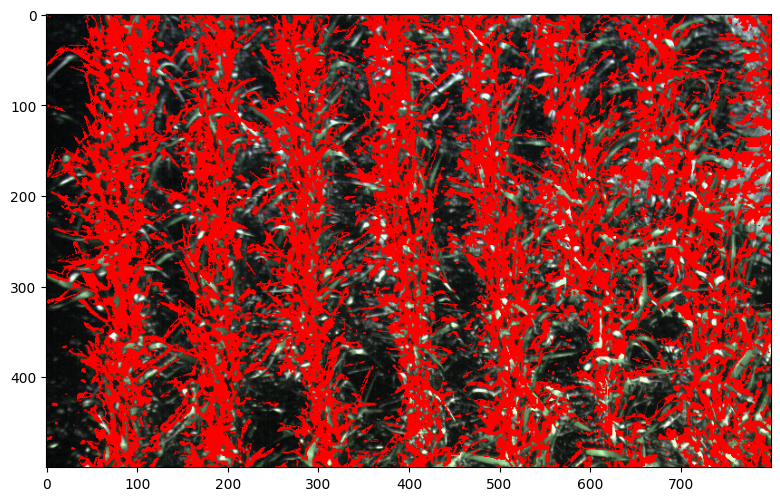

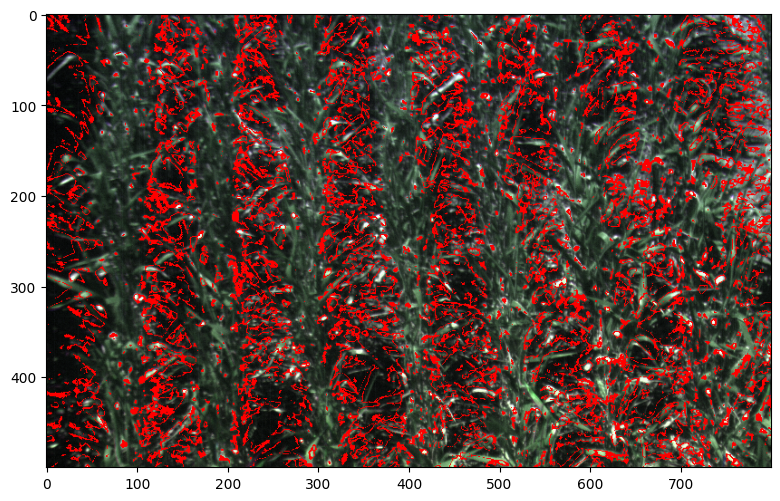

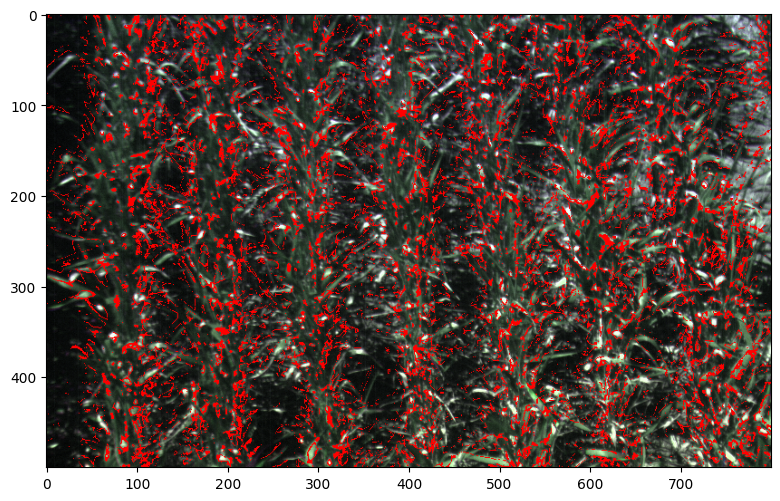

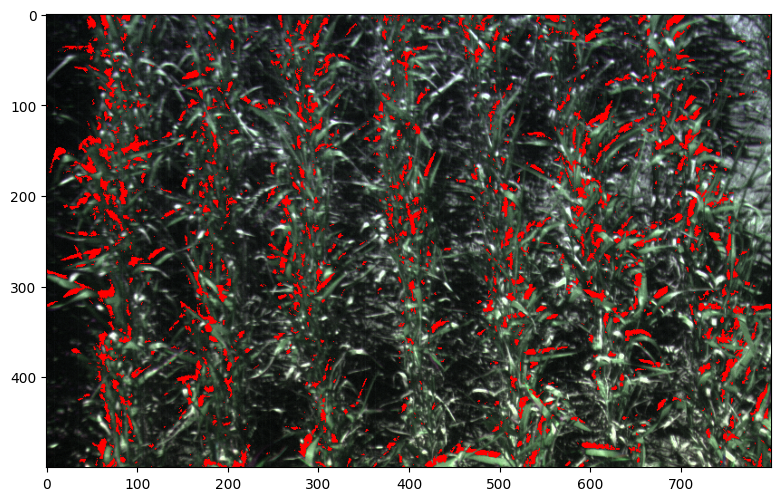

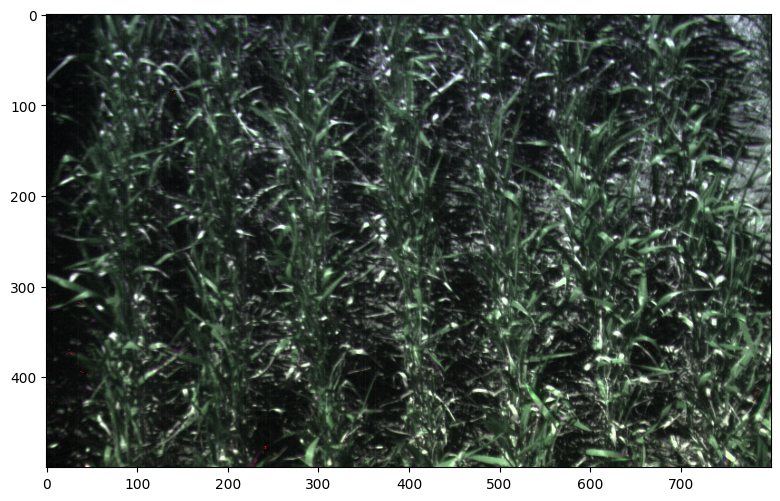

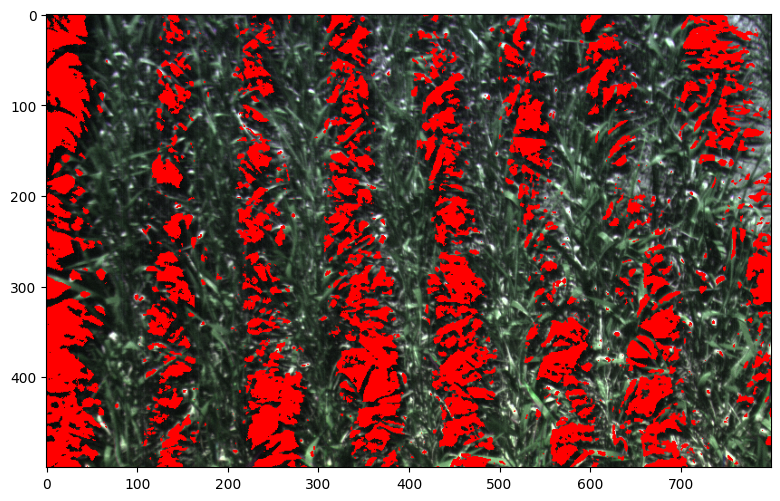

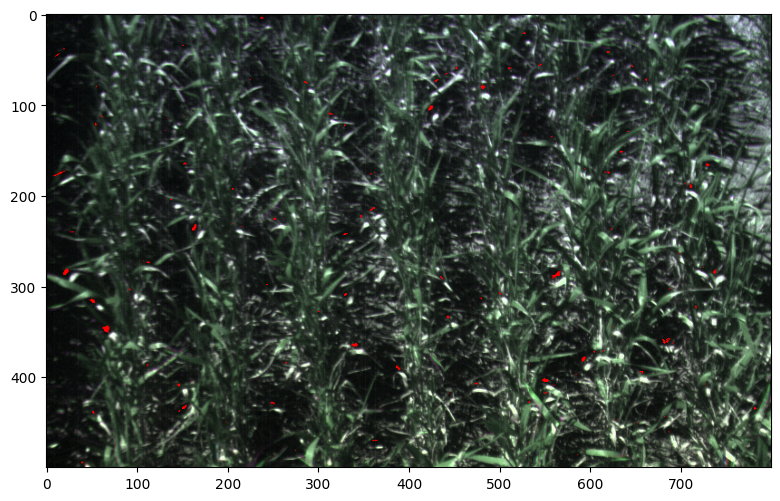

In [40]:
endmember_mask(imagen=pseudo_img2, algoritmo=PPI_P, ruta_save=ruta_s, figura=True, save=False)

##Selección de Endmember interactivo

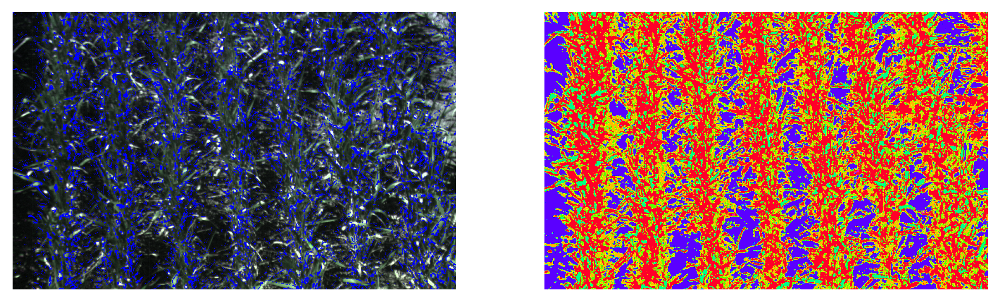

In [66]:
#@title Seleccione 3 endmembers a visualizar. { run: "auto" }
Algoritmo = 'PPI' #@param ["PPI", "FIPPI", "ATGP", "NFINDR"]
DPI = '300' #@param ["100", "150", "200", "250", "300"]
Sin_endmembers = False #@param {type:"boolean"}
if Algoritmo == 'PPI':
  metodo = PPI_P
if Algoritmo == 'FIPPI':
  metodo = FIPPI_P
if Algoritmo == 'ATGP':
  metodo = ATGP_P
if Algoritmo == 'NFINDR':
  metodo = NFINDR_P

Endmemberd_rojo = '2' #@param ["0", "1", "2", "3", "4", "5", "6"]
Endmemberd_cian = '2' #@param ["0", "1", "2", "3", "4", "5", "6"]
Endmemberd_azul = '2' #@param ["0", "1", "2", "3", "4", "5", "6"]
end1 = int(Endmemberd_rojo)
end2 = int(Endmemberd_cian)
end3 = int(Endmemberd_azul)

if Algoritmo == 'PPI' or Algoritmo == 'FIPPI':
  n_endmembers = data_unique(metodo)
  endmember_1 = n_endmembers[end1]
  endmember_2 = n_endmembers[end2]
  endmember_3 = n_endmembers[end3]

if Algoritmo == 'ATGP' or Algoritmo == 'NFINDR':
  if end1>1 or end2>1 or end3>1:
    print("Solo hay 2 endmembers, seleccione 0 o 1")
  else:
    n_endmembers = data_unique(metodo)
    endmember_1 = n_endmembers[end1]
    endmember_2 = n_endmembers[end2]
    endmember_3 = n_endmembers[end3]

endmember_mask_by_endmember(imagen=pseudo_img2, algoritmo=metodo, end_1=endmember_1, end_2=endmember_2, end_3=endmember_3, no_end=Sin_endmembers,  ruta_save='', figura=True, save=False, dpi=int(DPI))